# Importación de librerías

In [30]:
import os

import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
from PIL import Image
from torch.utils.data import DataLoader, Dataset

import config
from datasets import Content2PaintingDataset
from discriminator_model import Discriminator
from resnet_discriminator_model import ResNetDiscriminator
from generator_model import Generator
from train import train_fn
from tqdm import tqdm
from torchvision.utils import save_image
from utils import generate_test_images, preprocess_images
from metrics import *
from vgg_feature_extractor import VGGFeatureExtractor

# Inicialización de los modelos

In [31]:
def weights_init(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
        nn.init.xavier_normal_(m.weight)

In [32]:
# Initialize discriminator models
content_distriminator = Discriminator().to(config.DEVICE)
painting_discriminator = Discriminator().to(config.DEVICE)

content_distriminator.apply(weights_init)
painting_discriminator.apply(weights_init)

# Initialize generator models
content_generator = Generator(img_channels=3).to(config.DEVICE)
painting_generator = Generator(img_channels=3).to(config.DEVICE)

content_generator.apply(weights_init)
painting_generator.apply(weights_init)

Generator(
  (encoder_blocks): ModuleList(
    (0): ConvBlock(
      (conv_block): Sequential(
        (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (activation): Identity()
    )
    (1): ConvBlock(
      (conv_block): Sequential(
        (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
        (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (activation): ReLU()
    )
    (2): ConvBlock(
      (conv_block): Sequential(
        (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (activation): ReLU()
    )
  )
  (bottleneck): Sequential(
    (0): ResidualBlock(
      (block): Sequential(
        (0): ConvBlock(
          (conv_block): Sequential(
           

# Initialización de los DataLoaders

In [33]:
train_dataset = Content2PaintingDataset(
    content_dir=config.TRAIN_CONTENT_IMAGES_DIR,
    painting_dir=config.TRAIN_PAINTINGS_IMAGES_DIR,
    is_test=False
)

test_dataset = Content2PaintingDataset(
    content_dir=config.TEST_CONTENT_IMAGES_DIR,
    painting_dir=config.TEST_PAINTINGS_IMAGES_DIR,
    is_test=True
)

data_loader = DataLoader(
    train_dataset,
    batch_size=config.BATCH_SIZE,
    shuffle=True
)

test_data_loader = DataLoader(
    test_dataset,
    batch_size=1,
    shuffle=True
)

print(f"Train dataset size: {len(train_dataset)}")
print(f"Test dataset size: {len(test_dataset)}")

Train dataset size: 5267
Test dataset size: 500


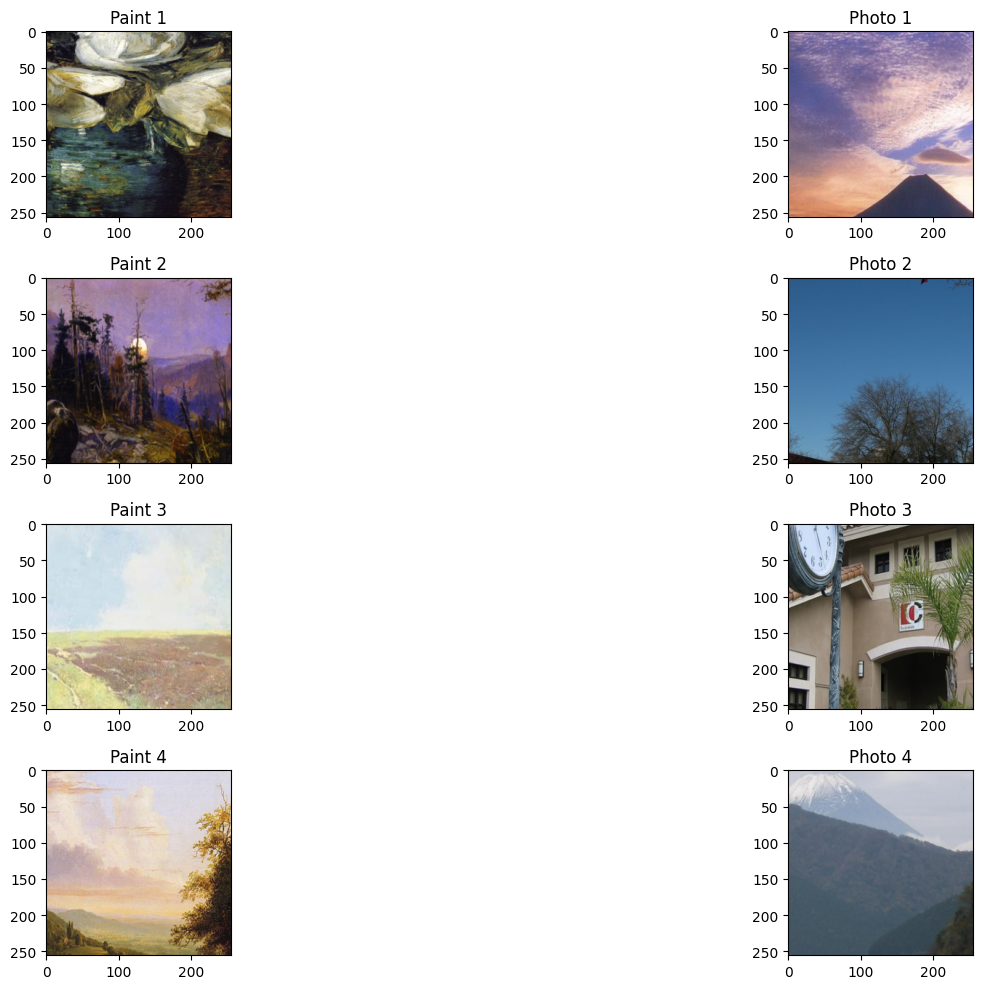

In [8]:
# Plot some photos from loader
plt.figure(figsize=(20, 10))

for i, (photo, paint) in enumerate(data_loader):
    if i == 4:
        break

    paint = paint * 0.5 + 0.5
    photo = photo * 0.5 + 0.5

    # Show paint image
    plt.subplot(4, 2, 2*i + 1)
    plt.title(f"Paint {i+1}")
    plt.imshow(paint[0].permute(1, 2, 0).cpu().numpy())

    # Show photo image
    plt.subplot(4, 2, 2*i + 2)
    plt.title(f"Photo {i+1}")
    plt.imshow(photo[0].permute(1, 2, 0).cpu().numpy())

plt.tight_layout()
plt.show()


# Entrenamiento de la red CycleGAN

## Primera iteración

Para esta primera iteración, se entrenará la red CycleGAN con los hiperparámetros siguientes:
- `lambda_cycle`: 10
- `lambda_identity`: 5
- `num_residual_blocks`: 6 (valor por defecto)

Solo se entrenará durante 5 epochs para ver el rendimiento de los hyperparámetros elegidos.

In [35]:
train_fn(
    content_distriminator,
    painting_discriminator,
    content_generator,
    painting_generator,
    data_loader,
    lambda_cycle=10.0,
    lambda_identity=5.0,
    epochs=5,
    iteration=1
)

Train on cuda
Epoch 1/5


100%|██████████| 5267/5267 [08:42<00:00, 10.08it/s]


Mean Generator Loss: 8.011527061462402

Mean Discriminator Loss: 0.39589524269104004

Epoch 2/5


100%|██████████| 5267/5267 [08:39<00:00, 10.14it/s]


Mean Generator Loss: 5.591917991638184

Mean Discriminator Loss: 0.39123770594596863

Epoch 3/5


100%|██████████| 5267/5267 [08:32<00:00, 10.28it/s]


Mean Generator Loss: 4.826451778411865

Mean Discriminator Loss: 0.40257513523101807

Epoch 4/5


100%|██████████| 5267/5267 [08:21<00:00, 10.50it/s]


Mean Generator Loss: 4.388235569000244

Mean Discriminator Loss: 0.40090426802635193

Epoch 5/5


100%|██████████| 5267/5267 [08:21<00:00, 10.50it/s]


Mean Generator Loss: 4.091350078582764

Mean Discriminator Loss: 0.39717745780944824



Una vez entrenada la red, se evaluará su rendimiento utilizando el conjunto de datos de prueba. A continuación, se realiza la transferecia de estilo entre las imágenes de prueba.

In [36]:
generated_content_path = "data/test_results/results/iteration_1/generated_content"
generated_paintings_path = "data/test_results/results/iteration_1/generated_paintings"

os.makedirs("data/test_results", exist_ok=True)
generate_test_images(painting_generator, content_generator, test_data_loader, generated_content_path, generated_paintings_path)

100%|██████████| 500/500 [01:39<00:00,  5.04it/s]


También es necesario generar un conjunto de datos con las imágenes de prueba procesadas para poder aplicar métricas como FID y SSIM.

In [37]:
preprocessed_content_path = "data/preprocessed/preprocessed_content"
preprocessed_paintings_path = "data/preprocessed/preprocessed_paintings"

os.makedirs("data/preprocessed", exist_ok=True)
os.makedirs(preprocessed_content_path, exist_ok=True)
os.makedirs(preprocessed_paintings_path, exist_ok=True)

preprocess_images(config.TEST_CONTENT_IMAGES_DIR, preprocessed_content_path)
preprocess_images(config.TEST_PAINTINGS_IMAGES_DIR, preprocessed_paintings_path)

100%|██████████| 500/500 [00:05<00:00, 93.16it/s] 


Preprocessed images saved to data/preprocessed/preprocessed_content


100%|██████████| 500/500 [00:08<00:00, 57.41it/s]

Preprocessed images saved to data/preprocessed/preprocessed_paintings


### FID: Frechet Inception Distance

Se calcula el FID entre las fotografías originales y las generadas por la red a partir de las pinturas.

In [45]:
compute_fid(
    preprocessed_content_path,
    generated_content_path,
)

FID score between data/preprocessed/preprocessed_content and data/test_results/results/iteration_1/generated_content: 136.32989501953125


136.32989501953125

Se calcula el FID entre las pinturas originales y las generadas por la red a partir de las fotografías.

In [46]:
compute_fid(
    preprocessed_paintings_path,
    generated_paintings_path,
)

FID score between data/preprocessed/preprocessed_paintings and data/test_results/results/iteration_1/generated_paintings: 135.47894287109375


135.47894287109375

### Content Loss

Se calcula la Content Loss entre las fotografías originales y las generadas por la red a partir de las pinturas.

In [39]:
average_content_loss = compute_content_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_1/generated_content',
    content_images_path='data/preprocessed/preprocessed_content',
    batch_size=1,
    layer='21'
)

Average Content Loss: 12.554262857437134


Se calcula la Content Loss entre las pinturas originales y las generadas por la red a partir de las fotografías.

In [40]:
average_content_loss = compute_content_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_1/generated_paintings',
    content_images_path='data/preprocessed/preprocessed_paintings',
    batch_size=1,
    layer='21'
)

Average Content Loss: 12.258238354682922


### Style Loss

Se calcula la Style Loss entre las fotografías originales y las generadas por la red a partir de las pinturas.

In [41]:
average_style_loss = compute_style_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_1/generated_content',
    style_images_path='data/preprocessed/preprocessed_content',
    batch_size=1,
    layers=['0', '5', '10', '19', '28']
)

Average Style Loss: 0.0001395063968305976


Se calcula la Content Loss entre las pinturas originales y las generadas por la red a partir de las fotografías.

In [42]:
average_style_loss = compute_style_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_1/generated_paintings',
    style_images_path='data/preprocessed/preprocessed_paintings',
    batch_size=1,
    layers=['0', '5', '10', '19', '28']
)

Average Style Loss: 0.00012080227603533444


### SSIM: Structural Similarity Index

Finalmente, se calcula el SSIM entre las imágenes generadas y las imágenes reales para el caso de imágenes de pintura al óleo.

[124, 429, 257, 282]
SSIM for image 124: 0.639694846536929


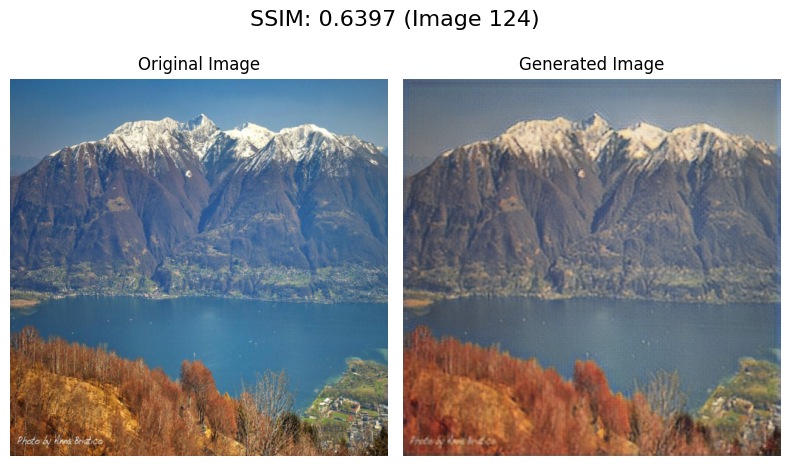

SSIM for image 429: 0.7246951275921883


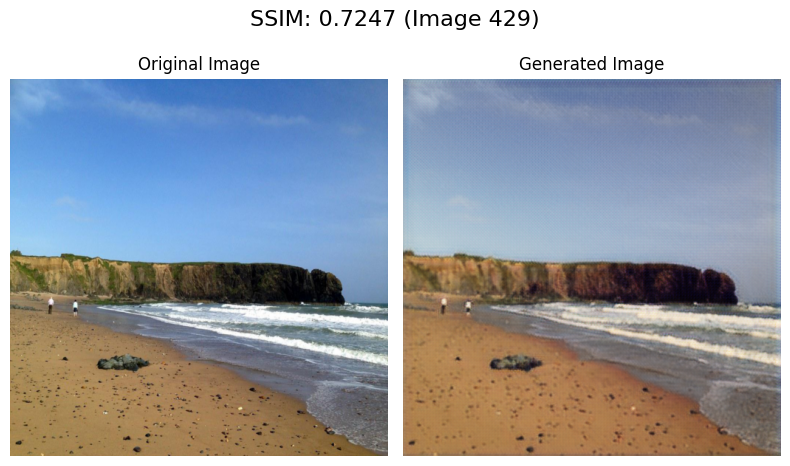

SSIM for image 257: 0.7903160902032776


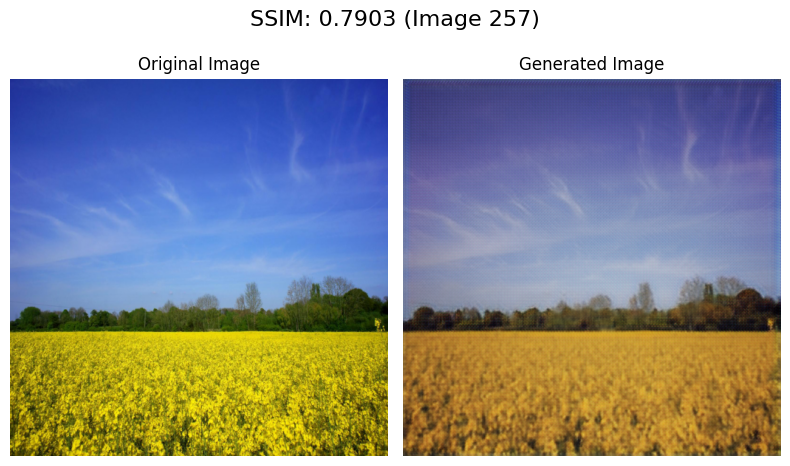

SSIM for image 282: 0.5572250772779649


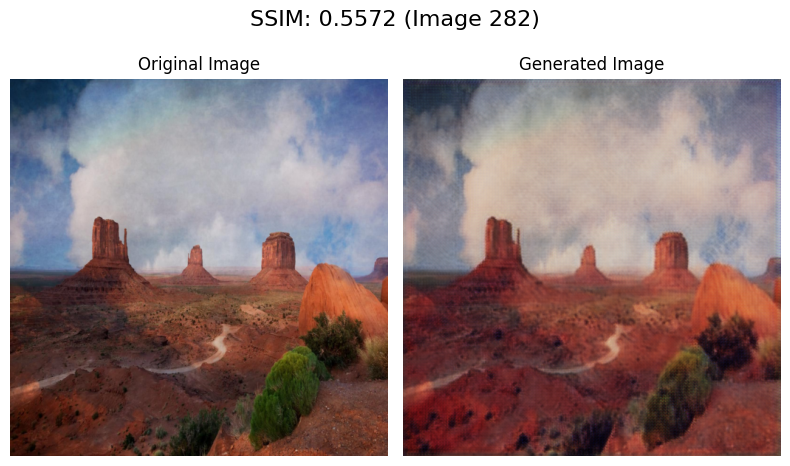


Average SSIM for the selected images: 0.6780


In [43]:
num_images = 4
seed=51
random.seed(seed)

# Obtener índices aleatorios
random_indices = random.sample(range(len(test_data_loader.dataset)), num_images)
print(random_indices)

# Evaluate SSIM on randomly selected images
evaluate_ssim_over_random_images(test_data_loader, painting_generator, random_indices)

[165, 485, 77, 202]
SSIM for image 165: 0.4896774017853392


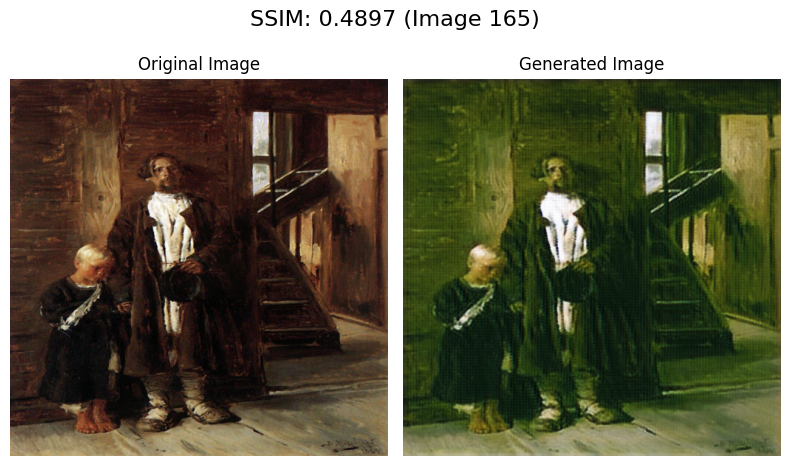

SSIM for image 485: 0.7650868250035925


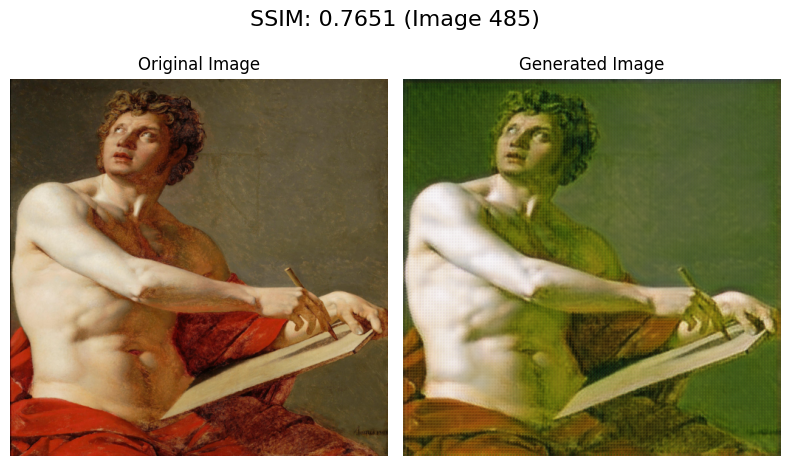

SSIM for image 77: 0.47018969639885455


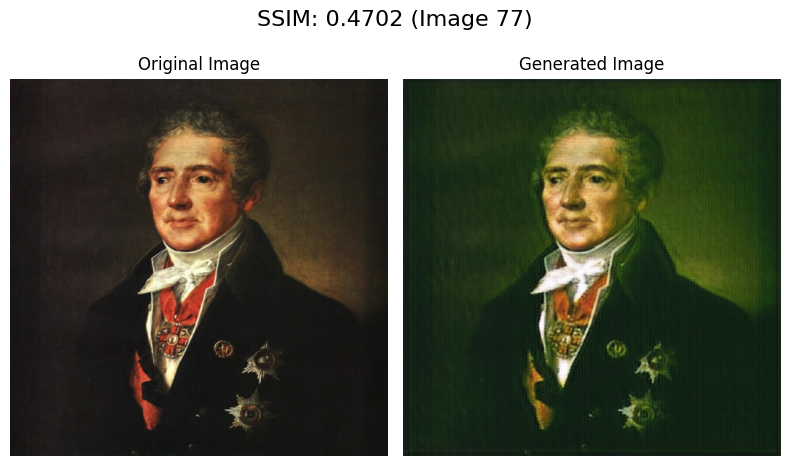

SSIM for image 202: 0.5905742532965358


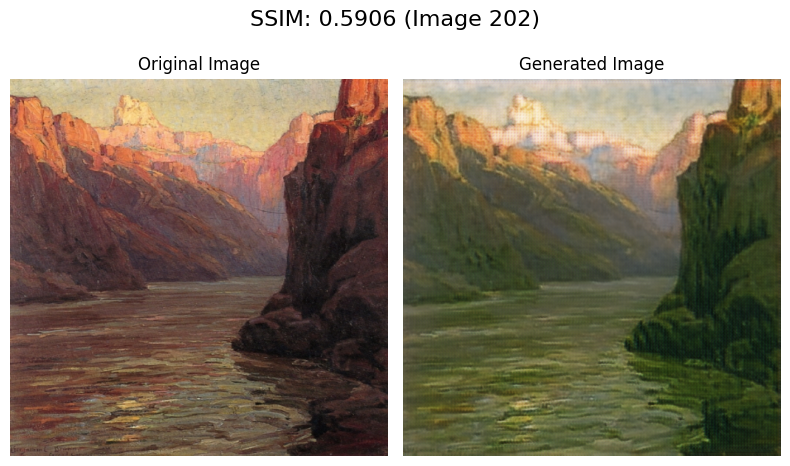


Average SSIM for the selected images: 0.5789


In [44]:
num_images = 4
seed=7
random.seed(seed)

# Obtener índices aleatorios
random_indices = random.sample(range(len(test_data_loader.dataset)), num_images)
print(random_indices)

evaluate_ssim_over_random_images(test_data_loader, content_generator, random_indices, is_paint=False)

## Segunda iteración

Para esta segunda iteración, se entrenará la red CycleGAN con los hiperparámetros siguientes:
- `lambda_cycle`: 30
- `lambda_identity`: 15
- `num_residual_blocks`: 9

In [7]:
# Initialize discriminator models
content_distriminator = Discriminator().to(config.DEVICE)
painting_discriminator = Discriminator().to(config.DEVICE)

content_distriminator.apply(weights_init)
painting_discriminator.apply(weights_init)

# Initialize generator models
content_generator = Generator(img_channels=3, num_residuals=9).to(config.DEVICE)
painting_generator = Generator(img_channels=3, num_residuals=9).to(config.DEVICE)

content_generator.apply(weights_init)
painting_generator.apply(weights_init)

train_fn(
    content_distriminator,
    painting_discriminator,
    content_generator,
    painting_generator,
    data_loader,
    lambda_cycle=30.0,
    lambda_identity=15.0,
    iteration=2,
    epochs=5,
)

Train on cuda
Epoch 1/5


100%|██████████| 5267/5267 [10:13<00:00,  8.58it/s]


Mean Generator Loss: 23.57295036315918

Mean Discriminator Loss: 0.18805396556854248

Epoch 2/5


100%|██████████| 5267/5267 [10:08<00:00,  8.66it/s]


Mean Generator Loss: 15.666364669799805

Mean Discriminator Loss: 0.09423238039016724

Epoch 3/5


100%|██████████| 5267/5267 [10:04<00:00,  8.71it/s]


Mean Generator Loss: 13.894046783447266

Mean Discriminator Loss: 0.16774195432662964

Epoch 4/5


100%|██████████| 5267/5267 [09:49<00:00,  8.93it/s]


Mean Generator Loss: 12.845755577087402

Mean Discriminator Loss: 0.27213233709335327

Epoch 5/5


100%|██████████| 5267/5267 [09:49<00:00,  8.93it/s]


Mean Generator Loss: 12.073966979980469

Mean Discriminator Loss: 0.3138576149940491



Una vez entrenada la red, se evaluará su rendimiento utilizando el conjunto de datos de prueba. A continuación, se realiza la transferecia de estilo entre las imágenes de prueba.

In [9]:
generated_content_path = "data/test_results/results/iteration_2/generated_content"
generated_paintings_path = "data/test_results/results/iteration_2/generated_paintings"

os.makedirs("data/test_results", exist_ok=True)
os.makedirs(generated_content_path, exist_ok=True)
os.makedirs(generated_paintings_path, exist_ok=True)

generate_test_images(painting_generator, content_generator, test_data_loader, generated_content_path, generated_paintings_path)

100%|██████████| 500/500 [01:43<00:00,  4.84it/s]


In [9]:
preprocessed_content_path = "data/preprocessed/preprocessed_content"
preprocessed_paintings_path = "data/preprocessed/preprocessed_paintings"

os.makedirs("data/preprocessed", exist_ok=True)
os.makedirs(preprocessed_content_path, exist_ok=True)
os.makedirs(preprocessed_paintings_path, exist_ok=True)

preprocess_images(config.TEST_CONTENT_IMAGES_DIR, preprocessed_content_path)
preprocess_images(config.TEST_PAINTINGS_IMAGES_DIR, preprocessed_paintings_path)

100%|██████████| 500/500 [00:05<00:00, 94.74it/s] 


Preprocessed images saved to data/preprocessed/preprocessed_content


100%|██████████| 500/500 [00:08<00:00, 56.73it/s]

Preprocessed images saved to data/preprocessed/preprocessed_paintings


### FID: Frechet Inception Distance

Se calcula el FID entre las imágenes generadas y las imágenes reales para el caso de imágenes de pintura al óleo.

In [12]:
compute_fid(
    preprocessed_paintings_path,
    generated_paintings_path
)

FID score between data/preprocessed/preprocessed_paintings and data/test_results/results/iteration_2/generated_paintings: 135.66262817382812


135.66262817382812

Se calcula el FID entre las imágenes generadas y las imágenes reales para el caso de fotografías

In [13]:
compute_fid(
    preprocessed_content_path,
    generated_content_path
)

FID score between data/preprocessed/preprocessed_content and data/test_results/results/iteration_2/generated_content: 139.6366424560547


139.6366424560547

### Content Loss

Se calcula la Content Loss entre las fotografías originales y las generadas por la red a partir de las pinturas.

In [14]:
average_content_loss = compute_content_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_2/generated_content',
    content_images_path='data/preprocessed/preprocessed_content',
    batch_size=1,
    layer='21'
)

Average Content Loss: 13.123062333583832


Se calcula la Content Loss entre las pinturas originales y las generadas por la red a partir de las fotografías.

In [15]:
average_content_loss = compute_content_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_2/generated_paintings',
    content_images_path='data/preprocessed/preprocessed_paintings',
    batch_size=1,
    layer='21'
)

Average Content Loss: 11.766321699142456


### Style Loss

Se calcula la Style Loss entre las fotografías originales y las generadas por la red a partir de las pinturas.

In [16]:
average_style_loss = compute_style_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_2/generated_content',
    style_images_path='data/preprocessed/preprocessed_content',
    batch_size=1,
    layers=['0', '5', '10', '19', '28']
)

Average Style Loss: 0.00013759786373478277


Se calcula la Content Loss entre las pinturas originales y las generadas por la red a partir de las fotografías.

In [17]:
average_style_loss = compute_style_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_2/generated_paintings',
    style_images_path='data/preprocessed/preprocessed_paintings',
    batch_size=1,
    layers=['0', '5', '10', '19', '28']
)

Average Style Loss: 0.00011411023668338771


### SSIM: Structural Similarity Index

Finalmente, se calcula el SSIM entre las imágenes generadas y las imágenes reales para el caso de imágenes de pintura al óleo.

[124, 429, 257, 282]
SSIM for image 124: 0.6787032296316897


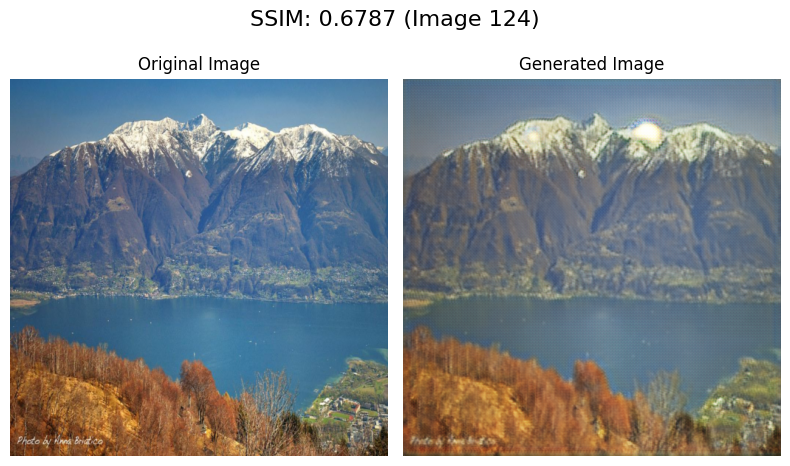

SSIM for image 429: 0.7145453974062587


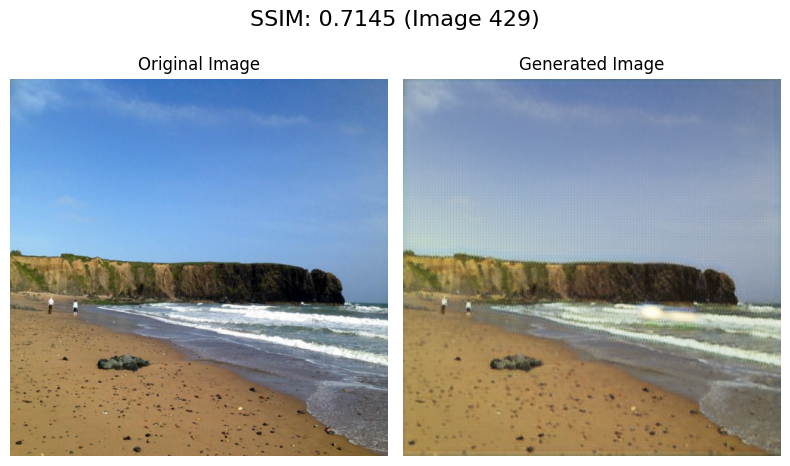

SSIM for image 257: 0.8417752951379539


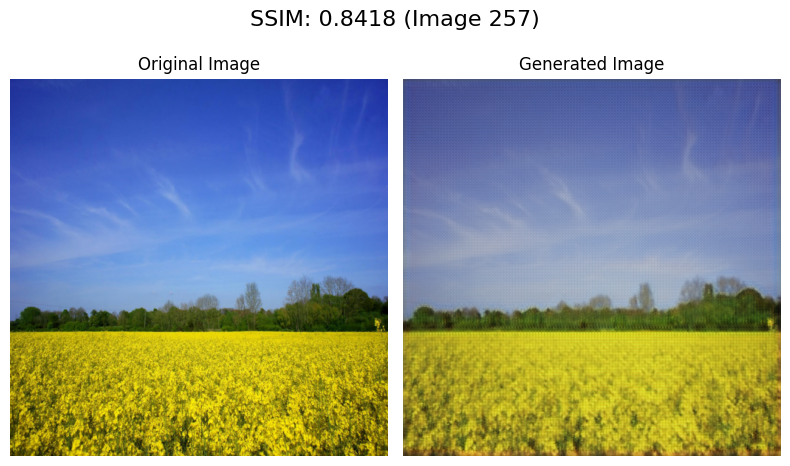

SSIM for image 282: 0.6867677279491459


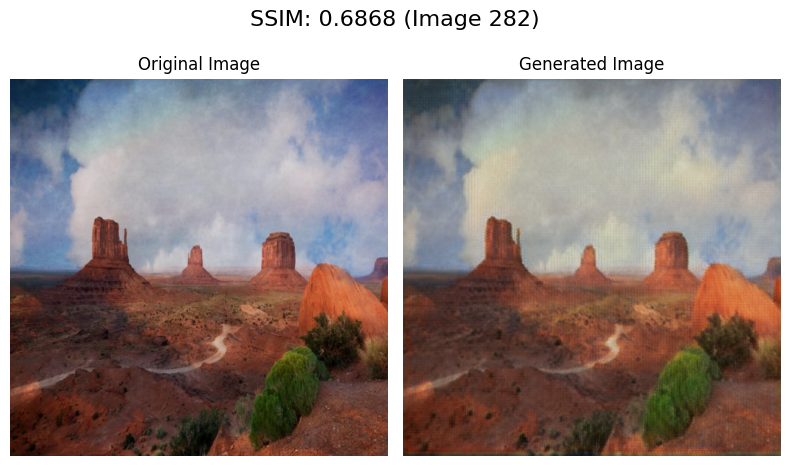


Average SSIM for the selected images: 0.7304


In [48]:
num_images = 4
seed=51
random.seed(seed)

# Obtener índices aleatorios
random_indices = random.sample(range(len(test_data_loader.dataset)), num_images)
print(random_indices)

evaluate_ssim_over_random_images(test_data_loader, painting_generator, random_indices)

Se calcula el SSIM entre las imágenes generadas y las imágenes reales para el caso de fotografías

[165, 485, 77, 202]
SSIM for image 165: 0.5519395029794746


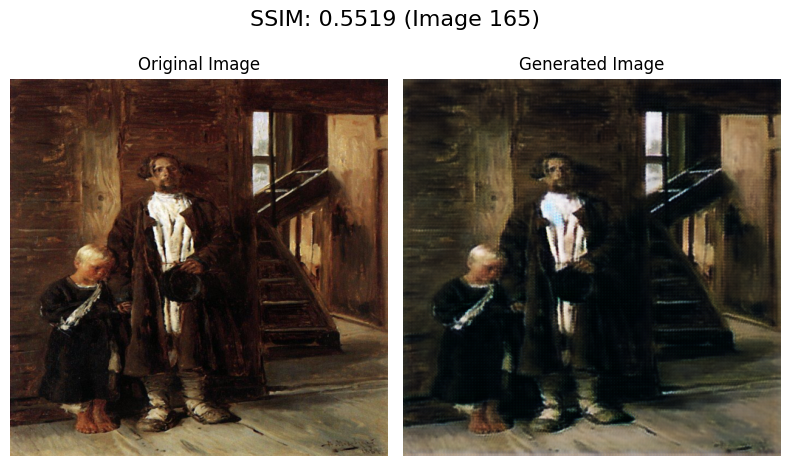

SSIM for image 485: 0.7875487559377041


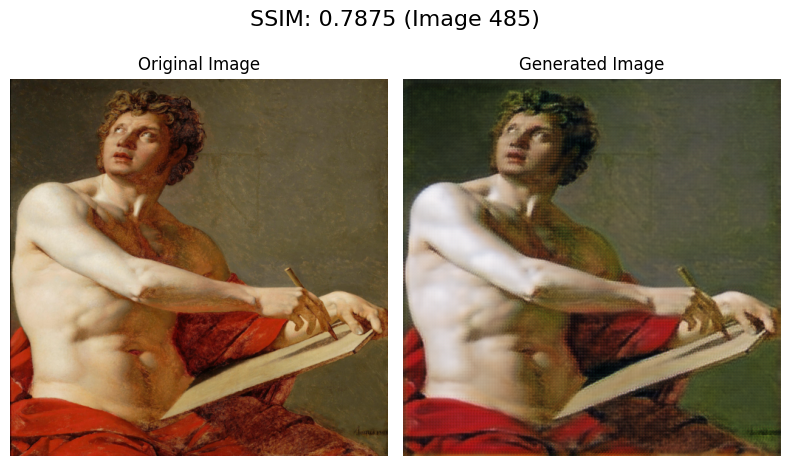

SSIM for image 77: 0.5586205773037449


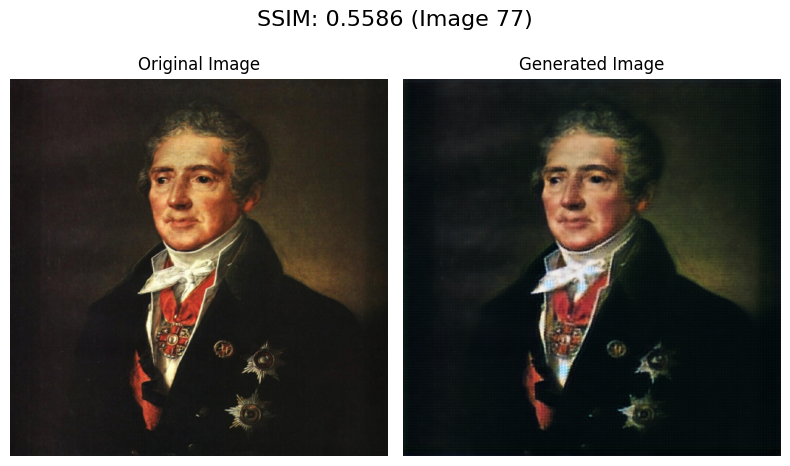

SSIM for image 202: 0.6661186842178004


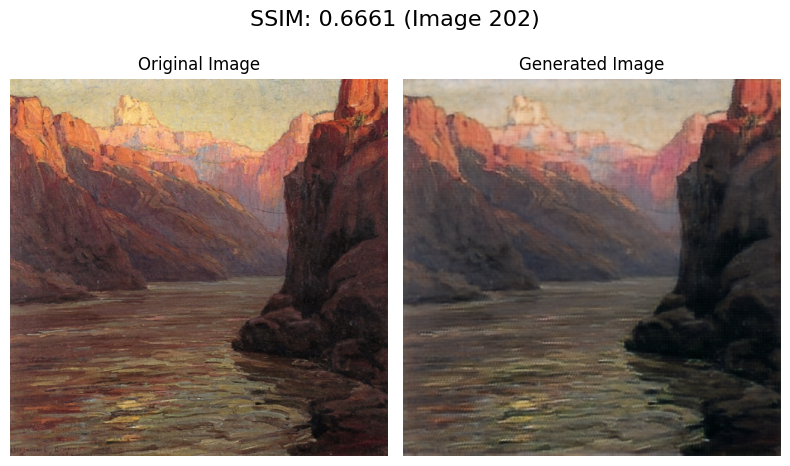


Average SSIM for the selected images: 0.6411


In [49]:
num_images = 4
seed=7
random.seed(seed)

# Obtener índices aleatorios
random_indices = random.sample(range(len(test_data_loader.dataset)), num_images)
print(random_indices)

evaluate_ssim_over_random_images(test_data_loader, content_generator, random_indices, is_paint=False)

## Tercera iteración

Para esta tercera iteración, se entrenará la red CycleGAN con los hiperparámetros siguientes:
- `lambda_cycle`: 10
- `lambda_identity`: 0.1
- `num_residual_blocks`: 9

In [47]:
# Initialize discriminator models
content_distriminator = Discriminator().to(config.DEVICE)
painting_discriminator = Discriminator().to(config.DEVICE)

content_distriminator.apply(weights_init)
painting_discriminator.apply(weights_init)

# Initialize generator models
content_generator = Generator(img_channels=3, num_residuals=9).to(config.DEVICE)
painting_generator = Generator(img_channels=3, num_residuals=9).to(config.DEVICE)

content_generator.apply(weights_init)
painting_generator.apply(weights_init)

train_fn(
    content_distriminator,
    painting_discriminator,
    content_generator,
    painting_generator,
    data_loader,
    lambda_cycle=10.0,
    lambda_identity=0.1,
    iteration=3,
    epochs=5,
)

Train on cuda
Epoch 1/5


100%|██████████| 5267/5267 [10:14<00:00,  8.57it/s]


Mean Generator Loss: 6.412155628204346

Mean Discriminator Loss: 0.33051684498786926

Epoch 2/5


100%|██████████| 5267/5267 [10:16<00:00,  8.54it/s]


Mean Generator Loss: 4.433666229248047

Mean Discriminator Loss: 0.36169782280921936

Epoch 3/5


100%|██████████| 5267/5267 [10:06<00:00,  8.69it/s]


Mean Generator Loss: 4.005127906799316

Mean Discriminator Loss: 0.39090394973754883

Epoch 4/5


100%|██████████| 5267/5267 [10:02<00:00,  8.74it/s]


Mean Generator Loss: 3.7522175312042236

Mean Discriminator Loss: 0.39684656262397766

Epoch 5/5


100%|██████████| 5267/5267 [09:59<00:00,  8.78it/s]


Mean Generator Loss: 3.5586998462677

Mean Discriminator Loss: 0.4052485525608063



Una vez entrenada la red, se evaluará su rendimiento utilizando el conjunto de datos de prueba. A continuación, se realiza la transferecia de estilo entre las imágenes de prueba.

In [48]:
generated_content_path = "data/test_results/results/iteration_3/generated_content"
generated_paintings_path = "data/test_results/results/iteration_3/generated_paintings"

os.makedirs("data/test_results", exist_ok=True)
os.makedirs(generated_content_path, exist_ok=True)
os.makedirs(generated_paintings_path, exist_ok=True)

generate_test_images(painting_generator, content_generator, test_data_loader, generated_content_path, generated_paintings_path)

100%|██████████| 500/500 [01:52<00:00,  4.43it/s]


In [49]:
preprocessed_content_path = "data/preprocessed/preprocessed_content"
preprocessed_paintings_path = "data/preprocessed/preprocessed_paintings"

os.makedirs("data/preprocessed", exist_ok=True)
os.makedirs(preprocessed_content_path, exist_ok=True)
os.makedirs(preprocessed_paintings_path, exist_ok=True)

preprocess_images(config.TEST_CONTENT_IMAGES_DIR, preprocessed_content_path)
preprocess_images(config.TEST_PAINTINGS_IMAGES_DIR, preprocessed_paintings_path)

100%|██████████| 500/500 [00:05<00:00, 94.89it/s] 


Preprocessed images saved to data/preprocessed/preprocessed_content


100%|██████████| 500/500 [00:08<00:00, 55.88it/s]

Preprocessed images saved to data/preprocessed/preprocessed_paintings


### FID: Frechet Inception Distance

Se calcula el FID entre las imágenes generadas y las imágenes reales para el caso de imágenes de pintura al óleo.

In [50]:
compute_fid(
    preprocessed_paintings_path,
    generated_paintings_path
)

FID score between data/preprocessed/preprocessed_paintings and data/test_results/results/iteration_3/generated_paintings: 125.52642822265625


125.52642822265625

Se calcula el FID entre las imágenes generadas y las imágenes reales para el caso de fotografías

In [51]:
compute_fid(
    preprocessed_content_path,
    generated_content_path
)

FID score between data/preprocessed/preprocessed_content and data/test_results/results/iteration_3/generated_content: 155.68524169921875


155.68524169921875

### Content Loss

Se calcula la Content Loss entre las fotografías originales y las generadas por la red a partir de las pinturas.

In [52]:
average_content_loss = compute_content_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_3/generated_content',
    content_images_path='data/preprocessed/preprocessed_content',
    batch_size=1,
    layer='21'
)

Average Content Loss: 11.869943092823029


Se calcula la Content Loss entre las pinturas originales y las generadas por la red a partir de las fotografías.

In [53]:
average_content_loss = compute_content_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_3/generated_paintings',
    content_images_path='data/preprocessed/preprocessed_paintings',
    batch_size=1,
    layer='21'
)

Average Content Loss: 11.968421879768371


### Style Loss

Se calcula la Style Loss entre las fotografías originales y las generadas por la red a partir de las pinturas.

In [54]:
average_style_loss = compute_style_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_3/generated_content',
    style_images_path='data/preprocessed/preprocessed_content',
    batch_size=1,
    layers=['0', '5', '10', '19', '28']
)

Average Style Loss: 0.0001342552108396262


Se calcula la Content Loss entre las pinturas originales y las generadas por la red a partir de las fotografías.

In [55]:
average_style_loss = compute_style_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_3/generated_paintings',
    style_images_path='data/preprocessed/preprocessed_paintings',
    batch_size=1,
    layers=['0', '5', '10', '19', '28']
)

Average Style Loss: 0.00011936265859219475


### SSIM: Structural Similarity Index

Finalmente, se calcula el SSIM entre las imágenes generadas y las imágenes reales para el caso de imágenes de pintura al óleo.

[124, 429, 257, 282]
SSIM for image 124: 0.132987851672137


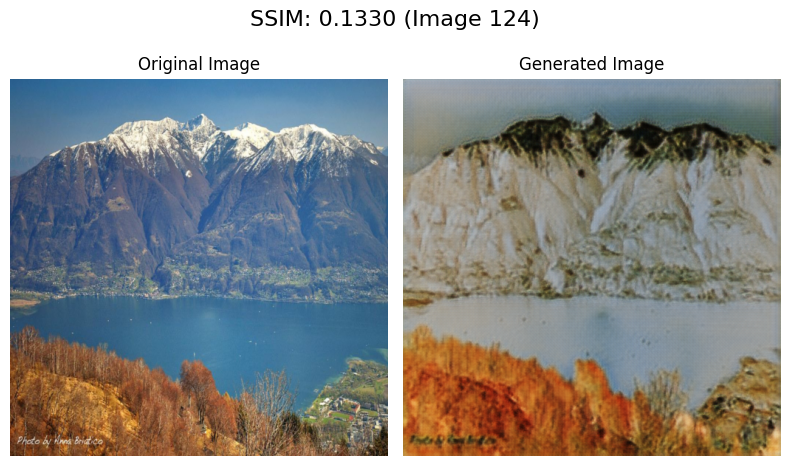

SSIM for image 429: 0.5403997613644329


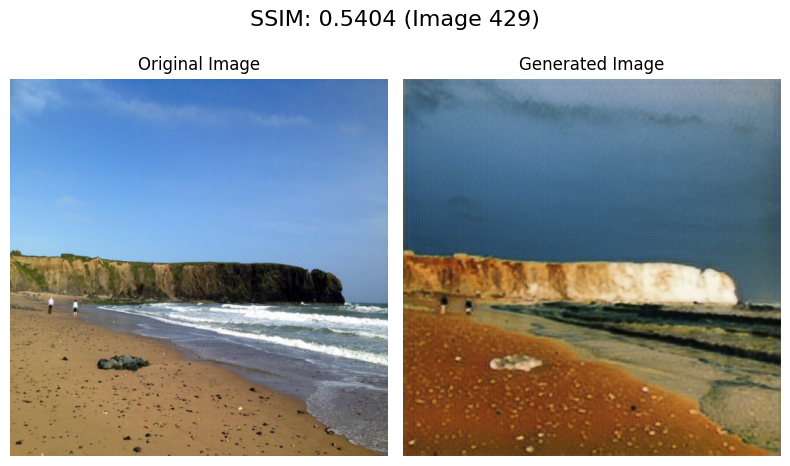

SSIM for image 257: 0.543300404814837


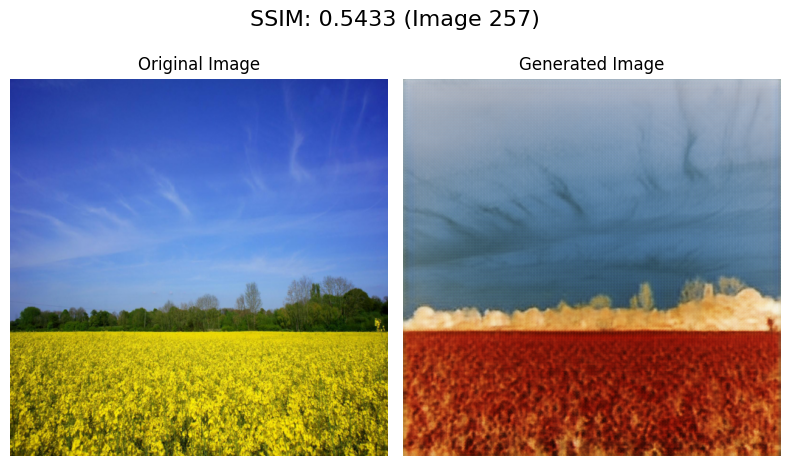

SSIM for image 282: 0.21334728190411328


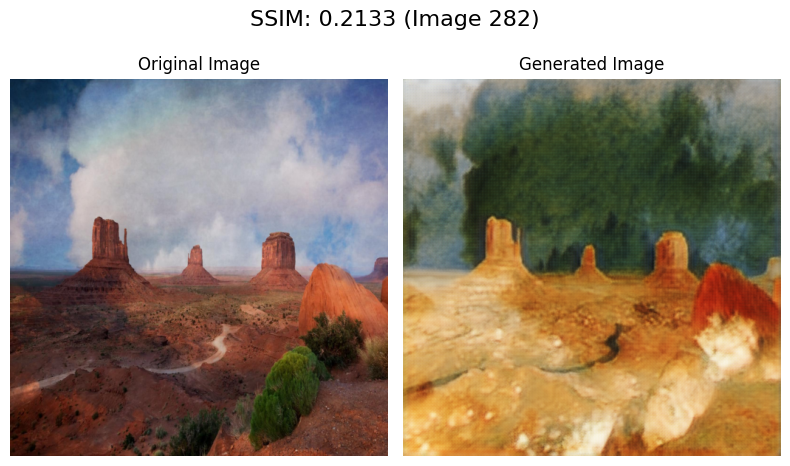


Average SSIM for the selected images: 0.3575


In [56]:
num_images = 4
seed=51
random.seed(seed)

# Obtener índices aleatorios
random_indices = random.sample(range(len(test_data_loader.dataset)), num_images)
print(random_indices)

evaluate_ssim_over_random_images(test_data_loader, painting_generator, random_indices)

Se calcula el SSIM entre las imágenes generadas y las imágenes reales para el caso de fotografías

[165, 485, 77, 202]
SSIM for image 165: -0.015131446970547238


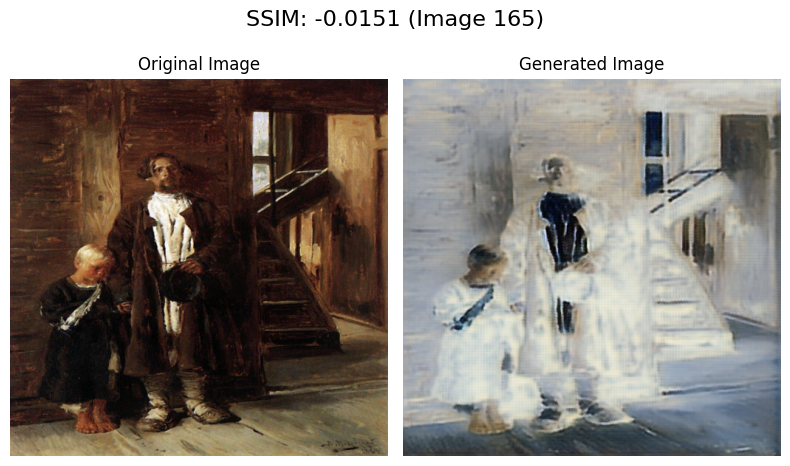

SSIM for image 485: -0.011109393976967525


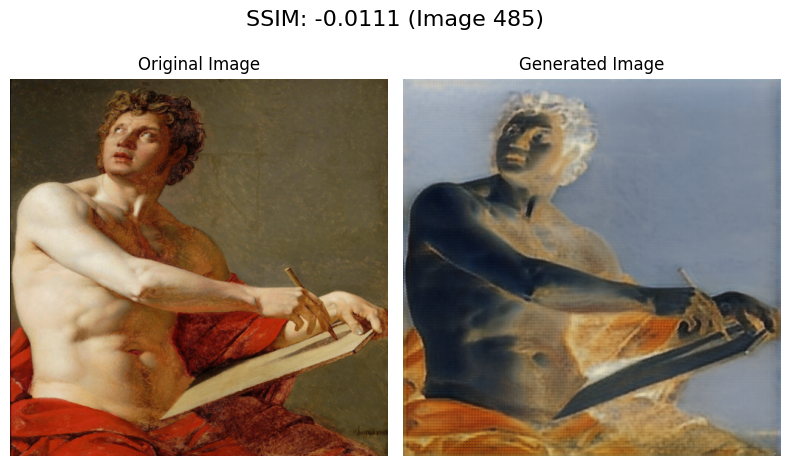

SSIM for image 77: 0.007155169423432341


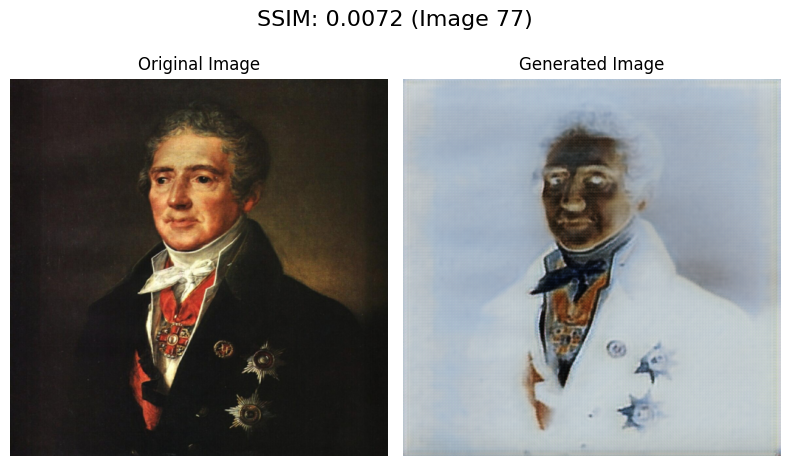

SSIM for image 202: -0.22994028261671093


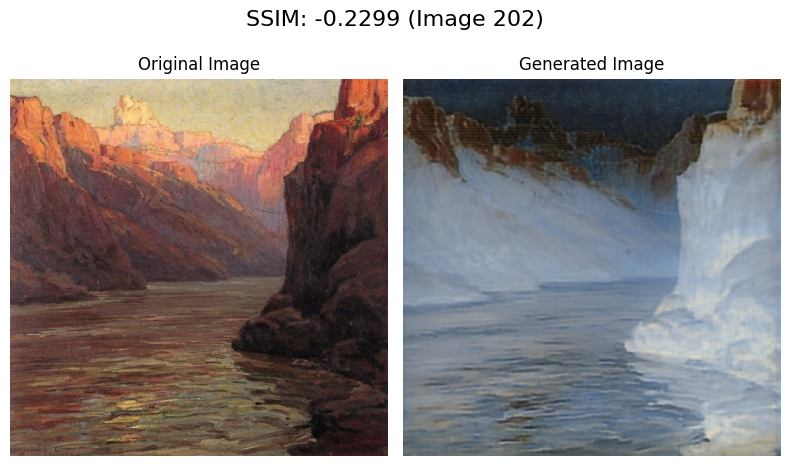


Average SSIM for the selected images: -0.0623


In [57]:
num_images = 4
seed=7
random.seed(seed)

# Obtener índices aleatorios
random_indices = random.sample(range(len(test_data_loader.dataset)), num_images)
print(random_indices)

evaluate_ssim_over_random_images(test_data_loader, content_generator, random_indices, is_paint=False)

## Cuarta iteración

Para esta primera iteración, se entrenará la red CycleGAN con los hiperparámetros siguientes:
- `lambda_cycle`: 10
- `lambda_identity`: 5
- `num_residual_blocks`: 9
- `Discriminator`: ResNetDiscriminator

Solo se entrenará durante 5 epochs para ver el rendimiento de los hyperparámetros elegidos.

In [18]:
# Initialize resnet discriminator models
content_distriminator = ResNetDiscriminator().to(config.DEVICE)
painting_discriminator = ResNetDiscriminator().to(config.DEVICE)

content_distriminator.apply(weights_init)
painting_discriminator.apply(weights_init)

# Initialize generator models
content_generator = Generator(img_channels=3, num_residuals=9).to(config.DEVICE)
painting_generator = Generator(img_channels=3, num_residuals=9).to(config.DEVICE)

content_generator.apply(weights_init)
painting_generator.apply(weights_init)

train_fn(
    content_distriminator,
    painting_discriminator,
    content_generator,
    painting_generator,
    data_loader,
    lambda_cycle=10.0,
    lambda_identity=5.0,
    iteration=4,
    epochs=5,
)

Train on cuda
Epoch 1/5


100%|██████████| 5267/5267 [11:38<00:00,  7.54it/s]


Mean Generator Loss: 8.218888282775879

Mean Discriminator Loss: 0.40372729301452637

Epoch 2/5


100%|██████████| 5267/5267 [11:38<00:00,  7.54it/s]


Mean Generator Loss: 5.307708263397217

Mean Discriminator Loss: 0.41895240545272827

Epoch 3/5


100%|██████████| 5267/5267 [11:28<00:00,  7.65it/s]


Mean Generator Loss: 4.758532524108887

Mean Discriminator Loss: 0.42839908599853516

Epoch 4/5


100%|██████████| 5267/5267 [11:21<00:00,  7.73it/s]


Mean Generator Loss: 4.449565887451172

Mean Discriminator Loss: 0.4263131022453308

Epoch 5/5


100%|██████████| 5267/5267 [11:13<00:00,  7.82it/s]


Mean Generator Loss: 4.228198051452637

Mean Discriminator Loss: 0.428019255399704



Una vez entrenada la red, se evaluará su rendimiento utilizando el conjunto de datos de prueba. A continuación, se realiza la transferecia de estilo entre las imágenes de prueba.

In [20]:
generated_content_path = "data/test_results/results/iteration_4/generated_content"
generated_paintings_path = "data/test_results/results/iteration_4/generated_paintings"

os.makedirs("data/test_results", exist_ok=True)
os.makedirs(generated_content_path, exist_ok=True)
os.makedirs(generated_paintings_path, exist_ok=True)

generate_test_images(painting_generator, content_generator, test_data_loader, generated_content_path, generated_paintings_path)

100%|██████████| 500/500 [01:20<00:00,  6.18it/s]


In [21]:
preprocessed_content_path = "data/preprocessed/preprocessed_content"
preprocessed_paintings_path = "data/preprocessed/preprocessed_paintings"

os.makedirs("data/preprocessed", exist_ok=True)
os.makedirs(preprocessed_content_path, exist_ok=True)
os.makedirs(preprocessed_paintings_path, exist_ok=True)

preprocess_images(config.TEST_CONTENT_IMAGES_DIR, preprocessed_content_path)
preprocess_images(config.TEST_PAINTINGS_IMAGES_DIR, preprocessed_paintings_path)

100%|██████████| 500/500 [00:05<00:00, 95.52it/s] 


Preprocessed images saved to data/preprocessed/preprocessed_content


100%|██████████| 500/500 [00:08<00:00, 56.10it/s]

Preprocessed images saved to data/preprocessed/preprocessed_paintings


### FID: Frechet Inception Distance

Se calcula el FID entre las imágenes generadas y las imágenes reales para el caso de imágenes de pintura al óleo.

In [22]:
compute_fid(
    preprocessed_paintings_path,
    generated_paintings_path
)

FID score between data/preprocessed/preprocessed_paintings and data/test_results/results/iteration_4/generated_paintings: 132.63671875


132.63671875

Se calcula el FID entre las imágenes generadas y las imágenes reales para el caso de fotografías

In [23]:
compute_fid(
    preprocessed_content_path,
    generated_content_path
)

FID score between data/preprocessed/preprocessed_content and data/test_results/results/iteration_4/generated_content: 143.0872344970703


143.0872344970703

### Content Loss

Se calcula la Content Loss entre las fotografías originales y las generadas por la red a partir de las pinturas.

In [24]:
average_content_loss = compute_content_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_4/generated_content',
    content_images_path='data/preprocessed/preprocessed_content',
    batch_size=1,
    layer='21'
)

Average Content Loss: 14.250369647979737


Se calcula la Content Loss entre las pinturas originales y las generadas por la red a partir de las fotografías.

In [25]:
average_content_loss = compute_content_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_4/generated_paintings',
    content_images_path='data/preprocessed/preprocessed_paintings',
    batch_size=1,
    layer='21'
)

Average Content Loss: 12.089695644378661


### Style Loss

Se calcula la Style Loss entre las fotografías originales y las generadas por la red a partir de las pinturas.

In [26]:
average_style_loss = compute_style_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_3/generated_content',
    style_images_path='data/preprocessed/preprocessed_content',
    batch_size=1,
    layers=['0', '5', '10', '19', '28']
)

Average Style Loss: 0.00014864035505178207


Se calcula la Content Loss entre las pinturas originales y las generadas por la red a partir de las fotografías.

In [27]:
average_style_loss = compute_style_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_3/generated_paintings',
    style_images_path='data/preprocessed/preprocessed_paintings',
    batch_size=1,
    layers=['0', '5', '10', '19', '28']
)

Average Style Loss: 0.00012033785868345603


### SSIM: Structural Similarity Index

Finalmente, se calcula el SSIM entre las imágenes generadas y las imágenes reales para el caso de imágenes de pintura al óleo.

[124, 429, 257, 282]
SSIM for image 124: 0.8236904693460383


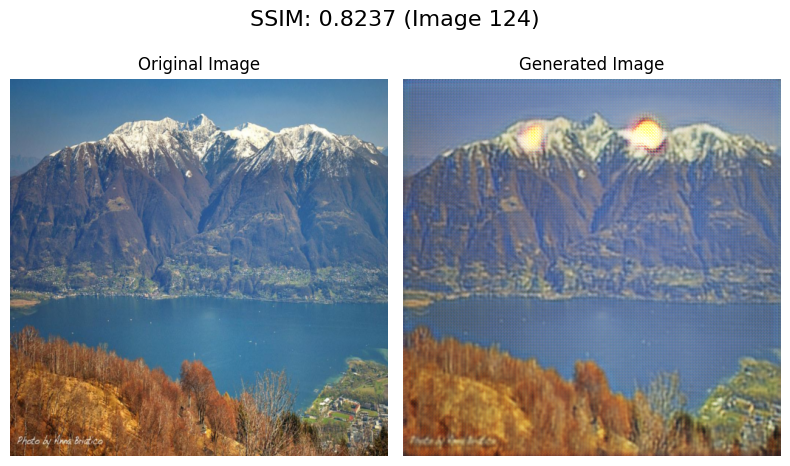

SSIM for image 429: 0.7741932546992848


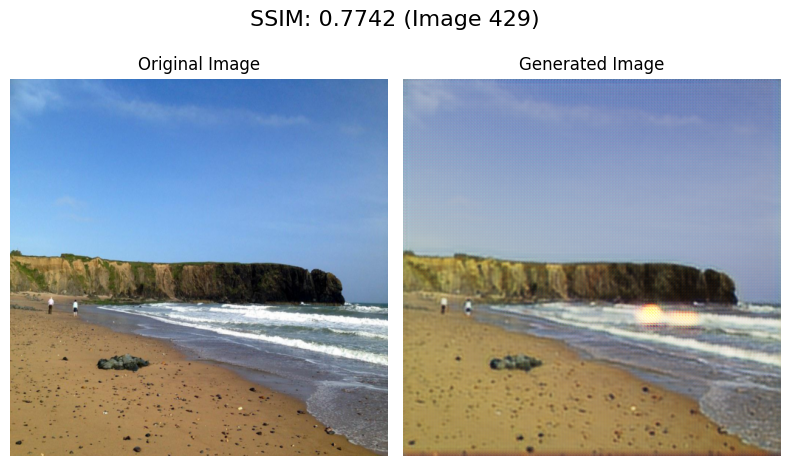

SSIM for image 257: 0.8461138199404523


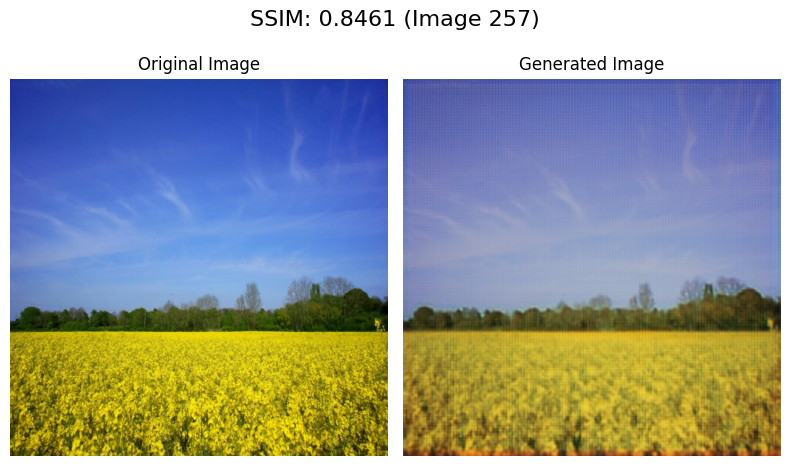

SSIM for image 282: 0.7092878103842087


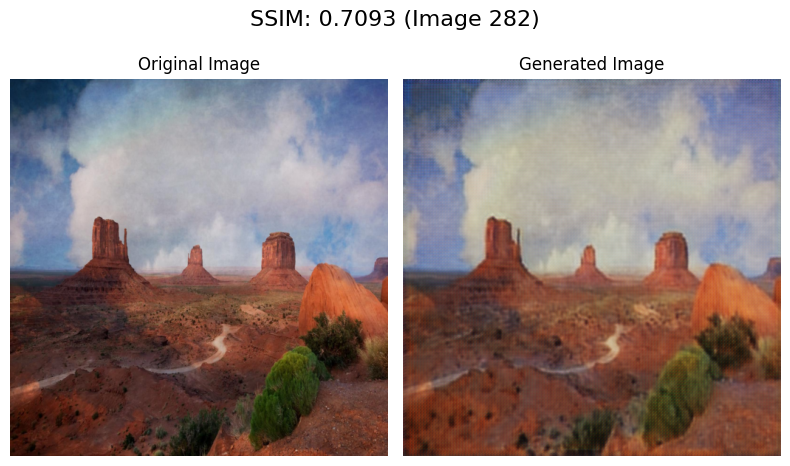


Average SSIM for the selected images: 0.7883


In [28]:
num_images = 4
seed=51
random.seed(seed)

# Obtener índices aleatorios
random_indices = random.sample(range(len(test_data_loader.dataset)), num_images)
print(random_indices)

evaluate_ssim_over_random_images(test_data_loader, painting_generator, random_indices)

Se calcula el SSIM entre las imágenes generadas y las imágenes reales para el caso de fotografías

[165, 485, 77, 202]
SSIM for image 165: 0.39515120832614153


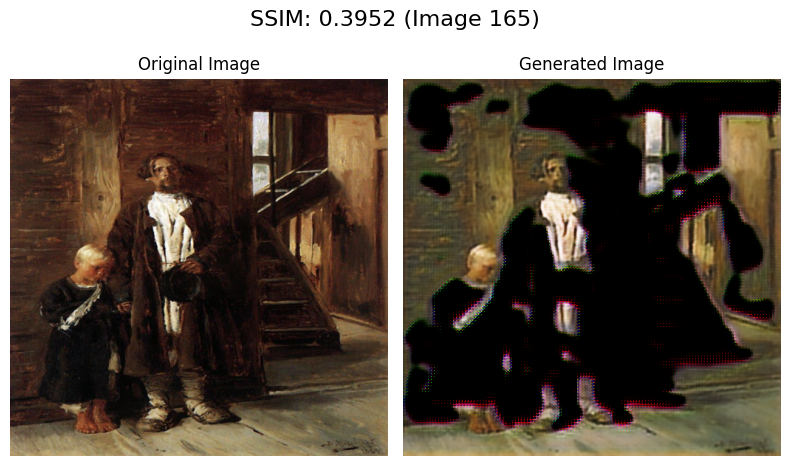

SSIM for image 485: 0.8461340531876982


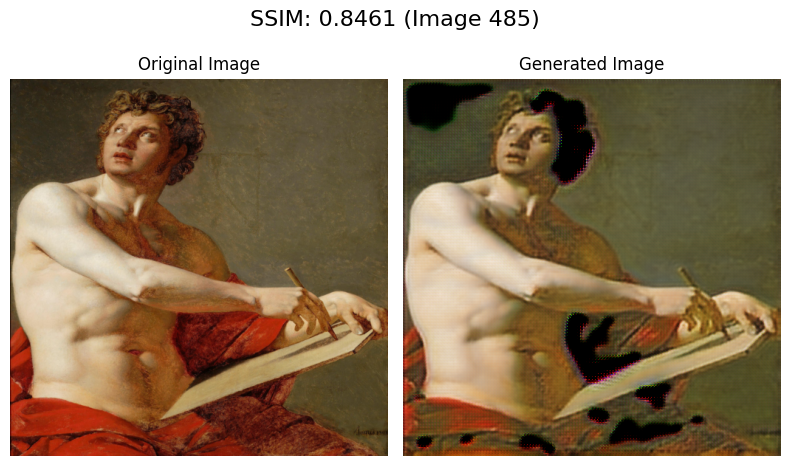

SSIM for image 77: 0.18202802751038785


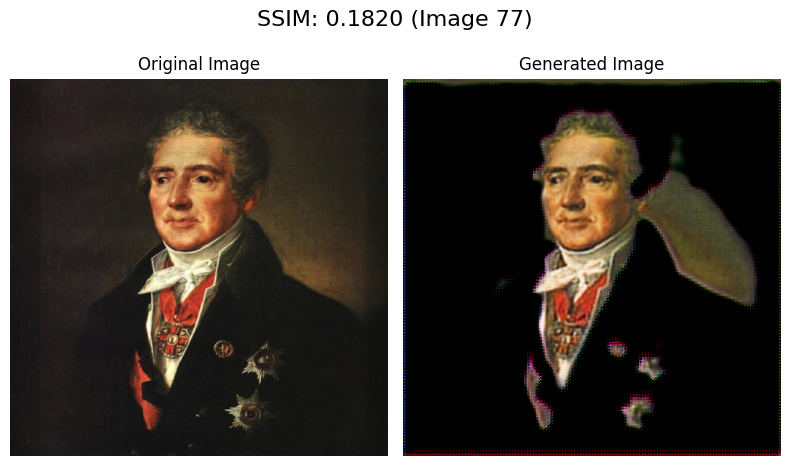

SSIM for image 202: 0.6948544598764042


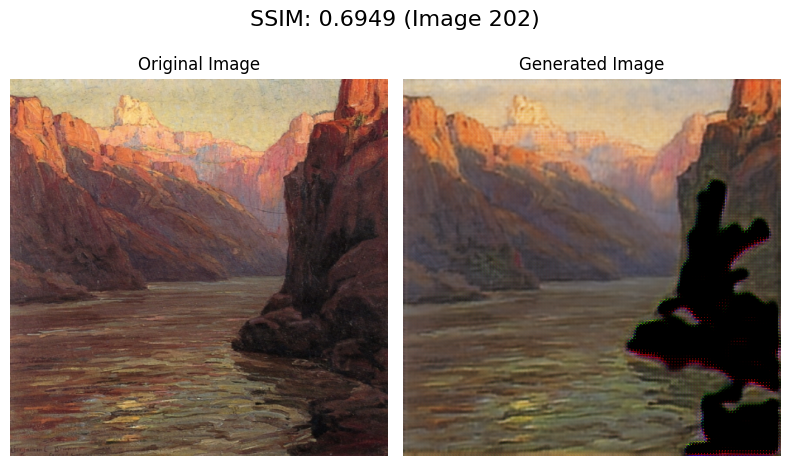


Average SSIM for the selected images: 0.5295


In [29]:
num_images = 4
seed=7
random.seed(seed)

# Obtener índices aleatorios
random_indices = random.sample(range(len(test_data_loader.dataset)), num_images)
print(random_indices)

evaluate_ssim_over_random_images(test_data_loader, content_generator, random_indices, is_paint=False)

# Entrenamiento final

Se determinó que se utilizarán los siguientes hiperparámetros para el entrenamiento final:

- `lambda_cycle`: 10
- `lambda_identity`: 5
- `num_residual_blocks`: 9
- `epochs`: 15

In [61]:
# Initialize discriminator models
content_distriminator = Discriminator().to(config.DEVICE)
painting_discriminator = Discriminator().to(config.DEVICE)

content_distriminator.apply(weights_init)
painting_discriminator.apply(weights_init)

# Initialize generator models
content_generator = Generator(img_channels=3, num_residuals=9).to(config.DEVICE)
painting_generator = Generator(img_channels=3, num_residuals=9).to(config.DEVICE)

content_generator.apply(weights_init)
painting_generator.apply(weights_init)

train_fn(
    content_distriminator,
    painting_discriminator,
    content_generator,
    painting_generator,
    data_loader,
    lambda_cycle=10.0,
    lambda_identity=5.0,
    iteration=5,
    epochs=15,
)

Train on cuda
Epoch 1/15


100%|██████████| 5267/5267 [10:18<00:00,  8.51it/s]


Mean Generator Loss: 8.148045539855957

Mean Discriminator Loss: 0.3734261393547058

Epoch 2/15


100%|██████████| 5267/5267 [10:08<00:00,  8.65it/s]


Mean Generator Loss: 5.6785783767700195

Mean Discriminator Loss: 0.384732186794281

Epoch 3/15


100%|██████████| 5267/5267 [10:09<00:00,  8.64it/s]


Mean Generator Loss: 4.89979887008667

Mean Discriminator Loss: 0.39989325404167175

Epoch 4/15


100%|██████████| 5267/5267 [09:50<00:00,  8.92it/s]


Mean Generator Loss: 4.529529571533203

Mean Discriminator Loss: 0.4045161306858063

Epoch 5/15


100%|██████████| 5267/5267 [09:52<00:00,  8.90it/s]


Mean Generator Loss: 4.281232833862305

Mean Discriminator Loss: 0.4048555791378021

Epoch 6/15


100%|██████████| 5267/5267 [10:02<00:00,  8.75it/s]


Mean Generator Loss: 4.008312225341797

Mean Discriminator Loss: 0.40940555930137634

Epoch 7/15


100%|██████████| 5267/5267 [10:06<00:00,  8.68it/s]


Mean Generator Loss: 3.7954695224761963

Mean Discriminator Loss: 0.4098441004753113

Epoch 8/15


100%|██████████| 5267/5267 [09:54<00:00,  8.87it/s]


Mean Generator Loss: 3.6576995849609375

Mean Discriminator Loss: 0.41160154342651367

Epoch 9/15


100%|██████████| 5267/5267 [09:57<00:00,  8.81it/s]


Mean Generator Loss: 3.544135808944702

Mean Discriminator Loss: 0.4093596339225769

Epoch 10/15


100%|██████████| 5267/5267 [09:58<00:00,  8.80it/s]


Mean Generator Loss: 3.4534494876861572

Mean Discriminator Loss: 0.41210150718688965

Epoch 11/15


100%|██████████| 5267/5267 [10:01<00:00,  8.75it/s]


Mean Generator Loss: 3.385146141052246

Mean Discriminator Loss: 0.4107036292552948

Epoch 12/15


100%|██████████| 5267/5267 [10:00<00:00,  8.77it/s]


Mean Generator Loss: 3.3294663429260254

Mean Discriminator Loss: 0.41156667470932007

Epoch 13/15


100%|██████████| 5267/5267 [09:57<00:00,  8.82it/s]


Mean Generator Loss: 3.260287284851074

Mean Discriminator Loss: 0.4125005006790161

Epoch 14/15


100%|██████████| 5267/5267 [10:01<00:00,  8.76it/s]


Mean Generator Loss: 3.1990132331848145

Mean Discriminator Loss: 0.41407984495162964

Epoch 15/15


100%|██████████| 5267/5267 [10:01<00:00,  8.76it/s]


Mean Generator Loss: 3.1521732807159424

Mean Discriminator Loss: 0.4119628965854645



Una vez entrenada la red, se evaluará su rendimiento utilizando el conjunto de datos de prueba. A continuación, se realiza la transferecia de estilo entre las imágenes de prueba.

In [62]:
generated_content_path = "data/test_results/results/iteration_5/generated_content"
generated_paintings_path = "data/test_results/results/iteration_5/generated_paintings"

os.makedirs("data/test_results", exist_ok=True)
os.makedirs(generated_content_path, exist_ok=True)
os.makedirs(generated_paintings_path, exist_ok=True)

generate_test_images(painting_generator, content_generator, test_data_loader, generated_content_path, generated_paintings_path)

100%|██████████| 500/500 [02:09<00:00,  3.86it/s]


In [63]:
preprocessed_content_path = "data/preprocessed/preprocessed_content"
preprocessed_paintings_path = "data/preprocessed/preprocessed_paintings"

os.makedirs("data/preprocessed", exist_ok=True)
os.makedirs(preprocessed_content_path, exist_ok=True)
os.makedirs(preprocessed_paintings_path, exist_ok=True)

preprocess_images(config.TEST_CONTENT_IMAGES_DIR, preprocessed_content_path)
preprocess_images(config.TEST_PAINTINGS_IMAGES_DIR, preprocessed_paintings_path)

100%|██████████| 500/500 [00:05<00:00, 95.16it/s] 


Preprocessed images saved to data/preprocessed/preprocessed_content


100%|██████████| 500/500 [00:08<00:00, 57.47it/s]

Preprocessed images saved to data/preprocessed/preprocessed_paintings


### FID: Frechet Inception Distance

Se calcula el FID entre las imágenes generadas y las imágenes reales para el caso de imágenes de pintura al óleo.

In [64]:
compute_fid(
    preprocessed_paintings_path,
    generated_paintings_path
)

FID score between data/preprocessed/preprocessed_paintings and data/test_results/results/iteration_5/generated_paintings: 133.58111572265625


133.58111572265625

Se calcula el FID entre las imágenes generadas y las imágenes reales para el caso de fotografías

In [65]:
compute_fid(
    preprocessed_content_path,
    generated_content_path
)

FID score between data/preprocessed/preprocessed_content and data/test_results/results/iteration_5/generated_content: 136.3841094970703


136.3841094970703

### Content Loss

Se calcula la Content Loss entre las fotografías originales y las generadas por la red a partir de las pinturas.

In [66]:
average_content_loss = compute_content_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_5/generated_content',
    content_images_path='data/preprocessed/preprocessed_content',
    batch_size=1,
    layer='21'
)

Average Content Loss: 12.660394867897034


Se calcula la Content Loss entre las pinturas originales y las generadas por la red a partir de las fotografías.

In [67]:
average_content_loss = compute_content_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_5/generated_paintings',
    content_images_path='data/preprocessed/preprocessed_paintings',
    batch_size=1,
    layer='21'
)

Average Content Loss: 11.737828100204467


### Style Loss

Se calcula la Style Loss entre las fotografías originales y las generadas por la red a partir de las pinturas.

In [70]:
average_style_loss = compute_style_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_5/generated_content',
    style_images_path='data/preprocessed/preprocessed_content',
    batch_size=1,
    layers=['0', '5', '10', '19', '28']
)

Average Style Loss: 0.00013895206582697028


Se calcula la Content Loss entre las pinturas originales y las generadas por la red a partir de las fotografías.

In [71]:
average_style_loss = compute_style_loss_over_dataset(
    generated_images_path='data/test_results/results/iteration_5/generated_paintings',
    style_images_path='data/preprocessed/preprocessed_paintings',
    batch_size=1,
    layers=['0', '5', '10', '19', '28']
)

Average Style Loss: 0.00011500952478471049


### SSIM: Structural Similarity Index

Finalmente, se calcula el SSIM entre las imágenes generadas y las imágenes reales para el caso de imágenes de pintura al óleo.

[473, 399, 485, 148]
SSIM for image 473: 0.41047525863962786


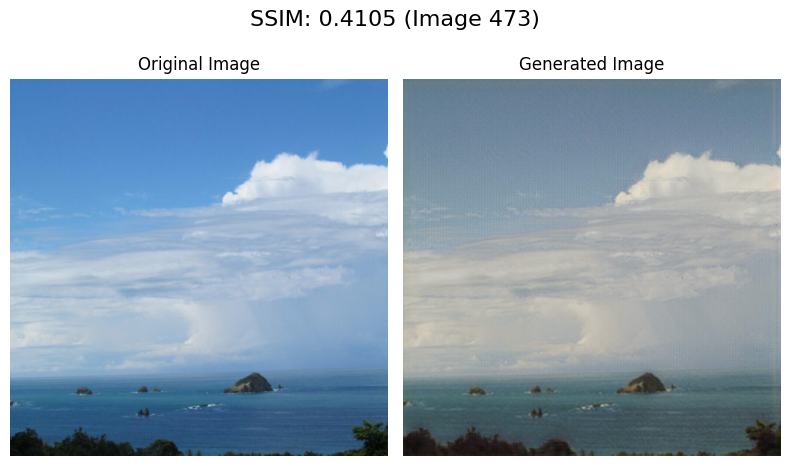

SSIM for image 399: 0.740098827190922


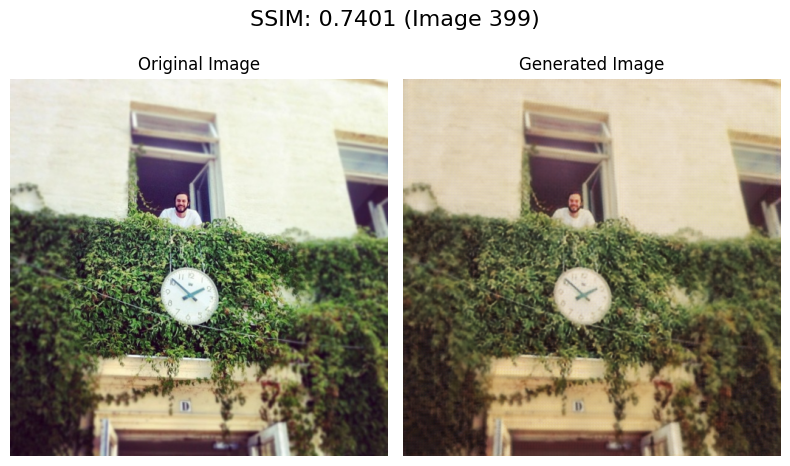

SSIM for image 485: 0.3180209874537861


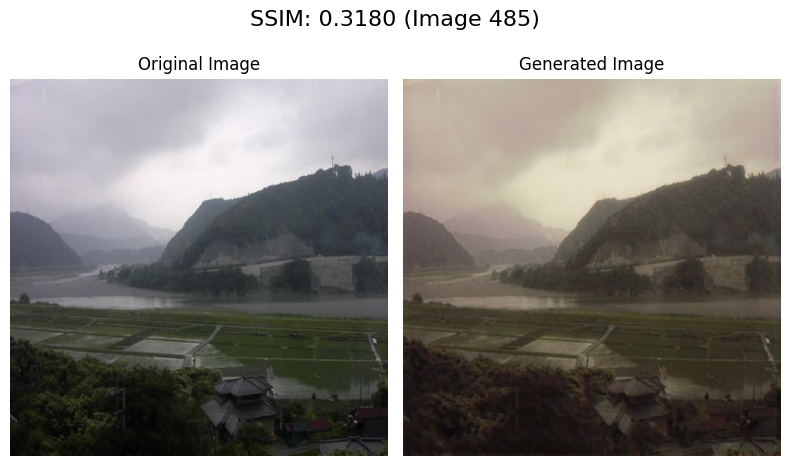

SSIM for image 148: 0.5717214179483973


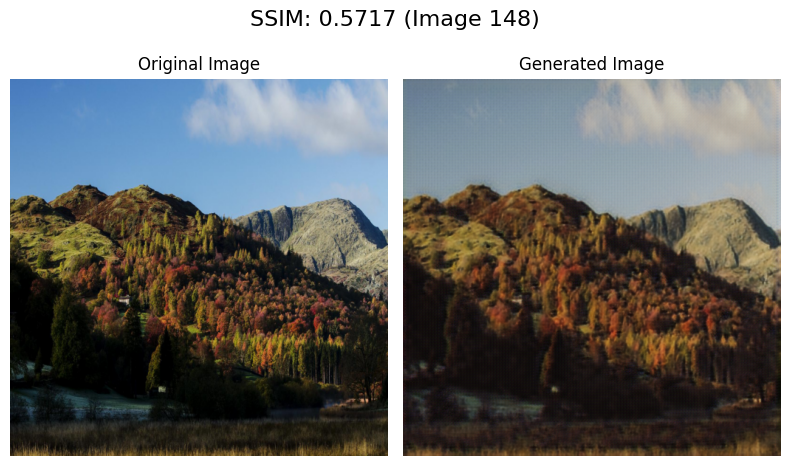


Average SSIM for the selected images: 0.5101


In [95]:
num_images = 4
seed=23
random.seed(seed)

# Obtener índices aleatorios
random_indices = random.sample(range(len(test_data_loader.dataset)), num_images)
print(random_indices)

evaluate_ssim_over_random_images(test_data_loader, painting_generator, random_indices)

[124, 429, 257, 282]
SSIM for image 124: 0.5762096622101317


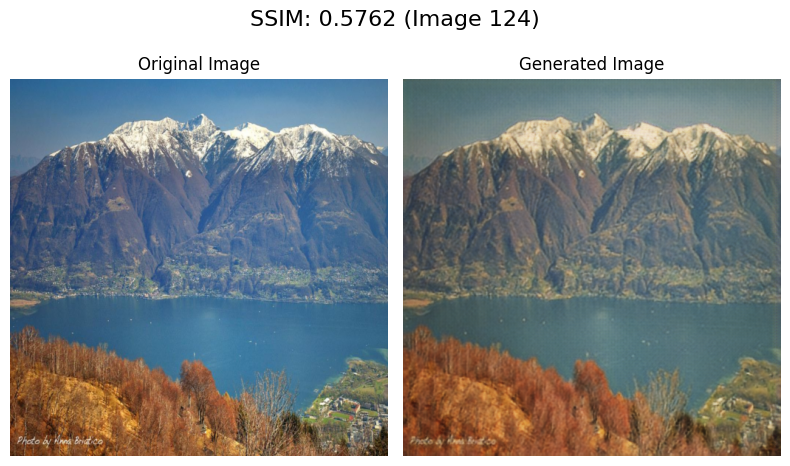

SSIM for image 429: 0.6439984556372674


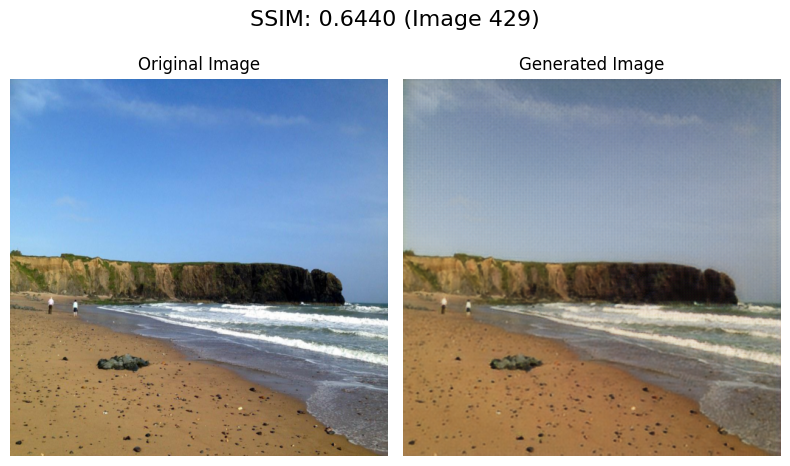

SSIM for image 257: 0.7265160868333358


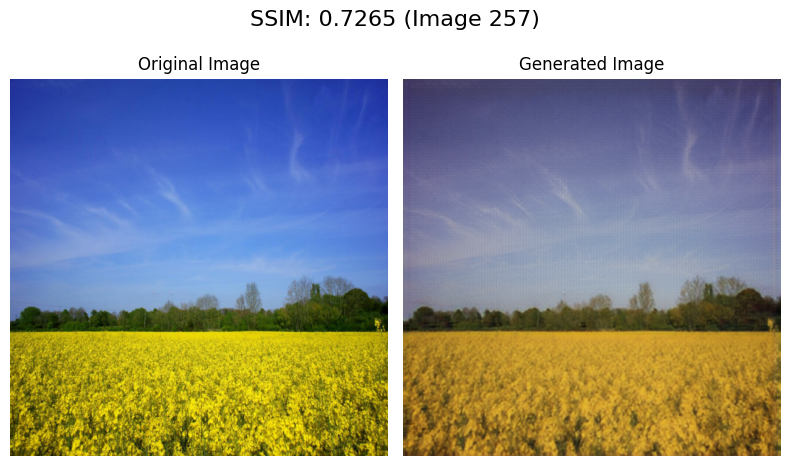

SSIM for image 282: 0.524900544815784


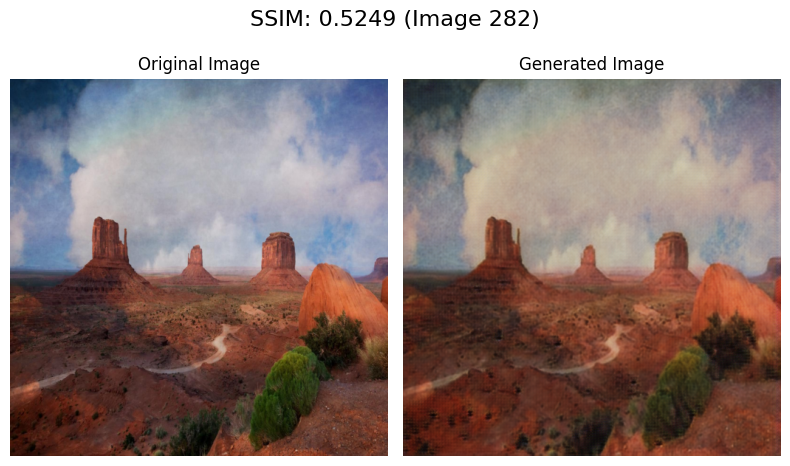


Average SSIM for the selected images: 0.6179


In [72]:
num_images = 4
seed=51
random.seed(seed)

# Obtener índices aleatorios
random_indices = random.sample(range(len(test_data_loader.dataset)), num_images)
print(random_indices)

evaluate_ssim_over_random_images(test_data_loader, painting_generator, random_indices)

Se calcula el SSIM entre las imágenes generadas y las imágenes reales para el caso de fotografías

[165, 485, 77, 202]
SSIM for image 165: 0.6437209494199477


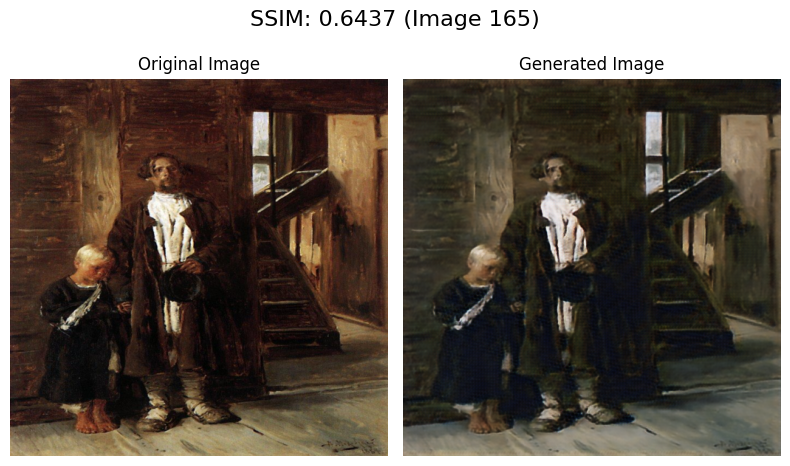

SSIM for image 485: 0.7401130857395816


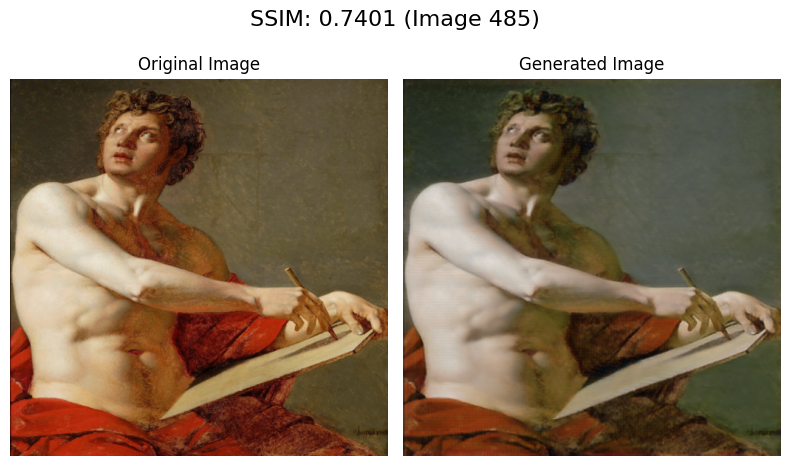

SSIM for image 77: 0.5596186140154412


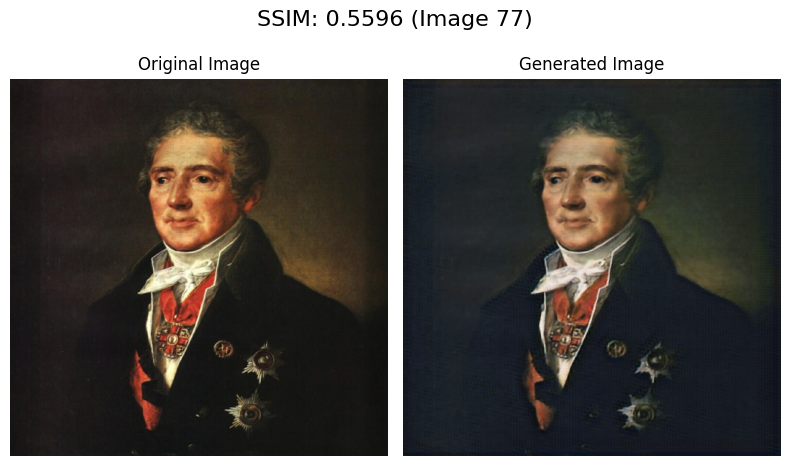

SSIM for image 202: 0.5645748081397949


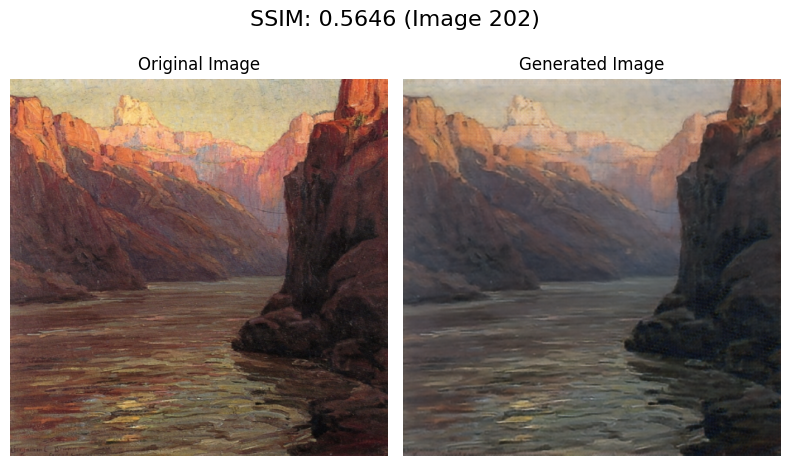


Average SSIM for the selected images: 0.6270


In [73]:
num_images = 4
seed=7
random.seed(seed)

# Obtener índices aleatorios
random_indices = random.sample(range(len(test_data_loader.dataset)), num_images)
print(random_indices)

evaluate_ssim_over_random_images(test_data_loader, content_generator, random_indices, is_paint=False)

Por último, se puede probar la consistencia de ciclo

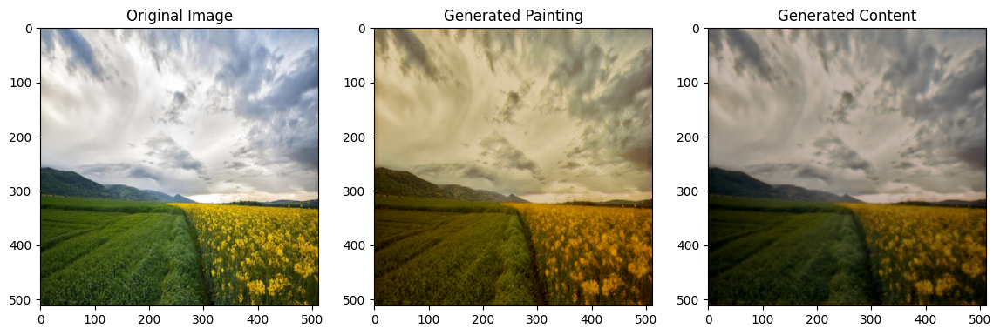

In [82]:
image_path = 'data/preprocessed/preprocessed_content/00000490.jpg'
image = Image.open(image_path)
image = torch.tensor(np.array(image), dtype=torch.float32).permute(2, 0, 1).unsqueeze(0) / 255.0
image = image.to(config.DEVICE)

# Generate the painting
fake_painting = painting_generator(image)
# Generate the content
fake_content = content_generator(fake_painting)

# Clamp the values to be between 0 and 1
fake_painting = fake_painting.clamp(0, 1)
fake_content = fake_content.clamp(0, 1)

plt.figure(figsize=(14, 8))

# Show original image
plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(image[0].permute(1, 2, 0).cpu().numpy())

# Show generated painting
plt.subplot(1, 3, 2)
plt.title("Generated Painting")
plt.imshow(fake_painting[0].permute(1, 2, 0).cpu().detach().numpy())

# Show generated content
plt.subplot(1, 3, 3)
plt.title("Generated Content")
plt.imshow(fake_content[0].permute(1, 2, 0).cpu().detach().numpy())

plt.show()

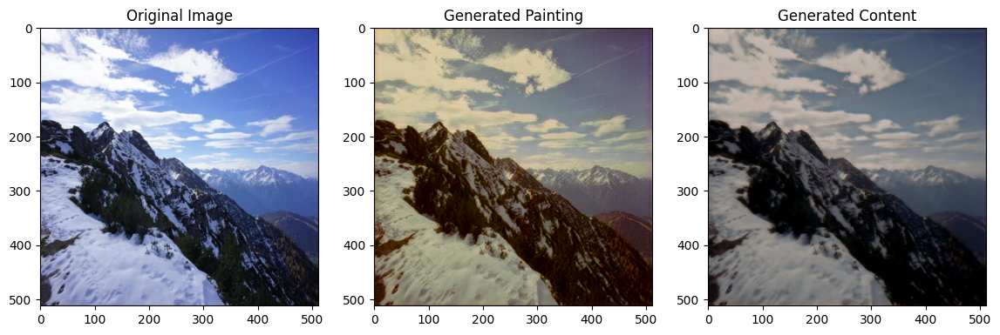

In [83]:
image_path = 'data/preprocessed/preprocessed_content/00000049.jpg'
image = Image.open(image_path)
image = torch.tensor(np.array(image), dtype=torch.float32).permute(2, 0, 1).unsqueeze(0) / 255.0
image = image.to(config.DEVICE)

# Generate the painting
fake_painting = painting_generator(image)
# Generate the content
fake_content = content_generator(fake_painting)

# Clamp the values to be between 0 and 1
fake_painting = fake_painting.clamp(0, 1)
fake_content = fake_content.clamp(0, 1)

plt.figure(figsize=(14, 8))

# Show original image
plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(image[0].permute(1, 2, 0).cpu().numpy())

# Show generated painting
plt.subplot(1, 3, 2)
plt.title("Generated Painting")
plt.imshow(fake_painting[0].permute(1, 2, 0).cpu().detach().numpy())

# Show generated content
plt.subplot(1, 3, 3)
plt.title("Generated Content")
plt.imshow(fake_content[0].permute(1, 2, 0).cpu().detach().numpy())

plt.show()

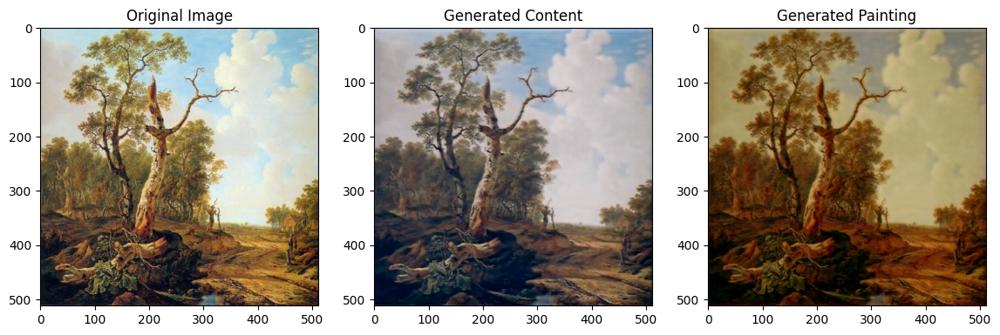

In [92]:
image_path = 'data/preprocessed/preprocessed_paintings/27209.jpg'
image = Image.open(image_path)
image = torch.tensor(np.array(image), dtype=torch.float32).permute(2, 0, 1).unsqueeze(0) / 255.0
image = image.to(config.DEVICE)

# Generate the painting
fake_content = content_generator(image)
# Generate the content
fake_painting = painting_generator(fake_content)

# Clamp the values to be between 0 and 1
fake_painting = fake_painting.clamp(0, 1)
fake_content = fake_content.clamp(0, 1)

plt.figure(figsize=(14, 8))

plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(image[0].permute(1, 2, 0).cpu().numpy())

plt.subplot(1, 3, 2)
plt.title("Generated Content")
plt.imshow(fake_content[0].permute(1, 2, 0).cpu().detach().numpy())

plt.subplot(1, 3, 3)
plt.title("Generated Painting")
plt.imshow(fake_painting[0].permute(1, 2, 0).cpu().detach().numpy())

plt.show()

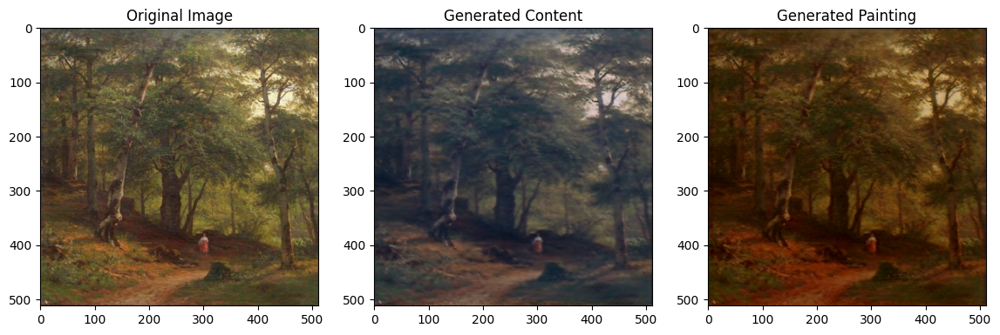

In [93]:
image_path = 'data/preprocessed/preprocessed_paintings/1776.jpg'
image = Image.open(image_path)
image = torch.tensor(np.array(image), dtype=torch.float32).permute(2, 0, 1).unsqueeze(0) / 255.0
image = image.to(config.DEVICE)

# Generate the painting
fake_content = content_generator(image)
# Generate the content
fake_painting = painting_generator(fake_content)

# Clamp the values to be between 0 and 1
fake_painting = fake_painting.clamp(0, 1)
fake_content = fake_content.clamp(0, 1)

plt.figure(figsize=(14, 8))

plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(image[0].permute(1, 2, 0).cpu().numpy())

plt.subplot(1, 3, 2)
plt.title("Generated Content")
plt.imshow(fake_content[0].permute(1, 2, 0).cpu().detach().numpy())

plt.subplot(1, 3, 3)
plt.title("Generated Painting")
plt.imshow(fake_painting[0].permute(1, 2, 0).cpu().detach().numpy())

plt.show()